In [1]:
import osmnx as ox
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString, Polygon
from shapely import wkt

# 동 경계 데이터, 서울시 도로 데이터 불러오기

## 1. 동 데이터 가져오기

In [2]:
# 서울시 행정동 데이터
dong_boundary = gpd.read_file('../emd/BND_ADM_DONG_PG.shp', encoding='CP949')
dong = dong_boundary[dong_boundary['ADM_CD'].str.startswith('11')]   # 서울시내 동 정보 추출
dong.to_crs(epsg=4326, inplace=True)

dong.head()

c:\Users\hongju\anaconda3\envs\hjenv\Lib\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,BASE_DATE,ADM_NM,ADM_CD,geometry
0,20230701,사직동,11010530,"POLYGON ((126.97399 37.57823, 126.97400 37.578..."
1,20230701,삼청동,11010540,"POLYGON ((126.97929 37.58349, 126.97931 37.583..."
2,20230701,부암동,11010550,"POLYGON ((126.96173 37.60714, 126.96182 37.607..."
3,20230701,평창동,11010560,"POLYGON ((126.97508 37.63118, 126.97488 37.630..."
4,20230701,한남동,11030740,"POLYGON ((127.00457 37.54980, 127.00457 37.549..."


In [3]:
# 동일한 신사동 구분
dong.loc[(dong['ADM_NM']=='신사동') & (dong['ADM_CD']=='11230510'), 'ADM_NM'] = '신사동(강남)'
dong.loc[(dong['ADM_NM']=='신사동') & (dong['ADM_CD']=='11210680'), 'ADM_NM'] = '신사동(은평)'

## 2. 동별 도로 네트워크 불러오기

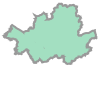

In [4]:
# 서울시 중심 좌표를 기준으로 경계 불러오기
seoul_boundary = dong.unary_union   # 모든 동의 경계를 합쳐서 서울시 경계 생성

seoul_boundary

In [5]:
# 2. 서울시 전체 도로 네트워크 불러오기
G_seoul = ox.graph_from_polygon(seoul_boundary, network_type='drive')

In [6]:
# 서울시내 도로 네트워크 정보 저장
nodes, edges = ox.graph_to_gdfs(G_seoul)

In [7]:
from cartoframes.viz import *

layer_seoul = Layer(edges,
                    basic_style(opacity=0.8), # 투명도
                    popup_hover=popup_element('name', title='도로명')) # 얹으면 팝업

layer_seoul

In [8]:
# 새로운 열 'neighbors'를 추가하여 지리적으로 인접한 동의 리스트를 저장
dong['neighbors'] = None  # 초기화

# 각 동에 대해 인접한 동 리스트 추가
for idx, row in dong.iterrows():
    # 현재 동(row['geometry'])의 경계와 인접한 동들을 찾습니다
    neighbors = dong[dong.touches(row['geometry'])].index.tolist()
    dong.at[idx, 'neighbors'] = neighbors

dong.head()

c:\Users\hongju\anaconda3\envs\hjenv\Lib\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,BASE_DATE,ADM_NM,ADM_CD,geometry,neighbors
0,20230701,사직동,11010530,"POLYGON ((126.97399 37.57823, 126.97400 37.578...","[184, 1076, 1078, 1080, 3474, 3476]"
1,20230701,삼청동,11010540,"POLYGON ((126.97929 37.58349, 126.97931 37.583...","[2, 87, 1076, 1077, 3475, 3476]"
2,20230701,부암동,11010550,"POLYGON ((126.96173 37.60714, 126.96182 37.607...","[1, 3, 87, 1076, 1368, 1372]"
3,20230701,평창동,11010560,"POLYGON ((126.97508 37.63118, 126.97488 37.630...","[2, 84, 87, 201, 1061, 1302, 1372]"
4,20230701,한남동,11030740,"POLYGON ((127.00457 37.54980, 127.00457 37.549...","[8, 9, 41, 1084, 1091, 1095, 1108, 1602, 1610]"


In [9]:
# 확인용
# sajik_n = dong.loc[dong['ADM_NM']=='사직동', "neighbors"]
# for idx in sajik_n:
#     print(dong.loc[idx, "ADM_NM"])

### 도로 전처리

In [10]:
# 노드 정보 확인
nodes.head()

,y,x,street_count,highway,ref,geometry
osmid,,,,,,
266813237,37.526615,127.000794,3,NaN,NaN,POINT (127.00079 37.52662)
278159482,37.525964,126.997422,3,NaN,NaN,POINT (126.99742 37.52596)
278159676,37.527696,127.002375,3,NaN,NaN,POINT (127.00238 37.52770)
282723724,37.588055,127.023541,3,NaN,NaN,POINT (127.02354 37.58805)
282723780,37.586624,127.025199,3,NaN,NaN,POINT (127.02520 37.58662)


In [11]:
# 간선 정보 확인
edges.head()

osmid    name      highway  oneway reversed  \
u         v          key                                                    
266813237 3771909762 0    373776969  보광로12길  residential   False    False   
          436847094  0    373776969  보광로12길  residential   False     True   
          3771899749 0    373776966  보광로14길  residential   False    False   
278159482 1378780898 0     25524218   보광로7길  residential   False    False   
          1378780857 0     97836950     장문로     tertiary   False    False   

                          length  \
u         v          key           
266813237 3771909762 0    27.605   
          436847094  0    20.002   
          3771899749 0    69.877   
278159482 1378780898 0    66.892   
          1378780857 0    22.683   

                                                                   geometry  \
u         v          key                                                      
266813237 3771909762 0    LINESTRING (127.00079 37.52662, 127.00109 37.5...   
          436847094  0    LINESTRING (127.00079 37.52662, 127.00062 37.5...   
          3771899749 0    LINESTRING (127.00079 37.52662, 127.00059 37.5...   
278159482 1378780898 0    LINESTRING (126.99742 37.52596, 126.99813 37.5...   
          1378780857 0    LINESTRING (126.99742 37.52596, 126.99717 37.5...   

                         lanes maxspeed  ref bridge tunnel junction access  \
u         v          key                                                     
266813237 3771909762 0     NaN      NaN  NaN    NaN    NaN      NaN    NaN   
          436847094  0     NaN      NaN  NaN    NaN    NaN      NaN    NaN   
          3771899749 0     NaN      NaN  NaN    NaN    NaN      NaN    NaN   
278159482 1378780898 0     NaN      NaN  NaN    NaN    NaN      NaN    NaN   
          1378780857 0     NaN      NaN  NaN    NaN    NaN      NaN    NaN   

                         width service  
u         v          key                
266813237 3771909762 0     NaN     NaN  
          436847094  0     NaN     NaN  
          3771899749 0     NaN     NaN  
278159482 1378780898 0     NaN     NaN  
          1378780857 0     NaN     NaN

In [12]:
# null 값 개수
nan_counts = edges.isna().sum()
print(nan_counts)
print(f"전체 도로 개수: {len(edges)}")

# 전체 개수에 비해 null인 값이 너무 많다. -> [osmid, name, highway, oneway, length, geometry, bridge, tunnel] 정도만 살리고 나머지 제거

osmid            0
name         16664
highway          0
oneway           0
reversed         0
length           0
geometry         0
lanes       175560
maxspeed    184504
ref         182918
bridge      187908
tunnel      188867
junction    189348
access      188854
width       189306
service     189488
dtype: int64
전체 도로 개수: 189490


In [13]:
# 사용할 정보만 가져오기
new_edges = edges[['osmid', 'name', 'highway', 'oneway', 'length', 'geometry', 'bridge', 'tunnel']]
new_edges.head()

osmid    name      highway  oneway  length  \
u         v          key                                                   
266813237 3771909762 0    373776969  보광로12길  residential   False  27.605   
          436847094  0    373776969  보광로12길  residential   False  20.002   
          3771899749 0    373776966  보광로14길  residential   False  69.877   
278159482 1378780898 0     25524218   보광로7길  residential   False  66.892   
          1378780857 0     97836950     장문로     tertiary   False  22.683   

                                                                   geometry  \
u         v          key                                                      
266813237 3771909762 0    LINESTRING (127.00079 37.52662, 127.00109 37.5...   
          436847094  0    LINESTRING (127.00079 37.52662, 127.00062 37.5...   
          3771899749 0    LINESTRING (127.00079 37.52662, 127.00059 37.5...   
278159482 1378780898 0    LINESTRING (126.99742 37.52596, 126.99813 37.5...   
          1378780857 0    LINESTRING (126.99742 37.52596, 126.99717 37.5...   

                         bridge tunnel  
u         v          key                
266813237 3771909762 0      NaN    NaN  
          436847094  0      NaN    NaN  
          3771899749 0      NaN    NaN  
278159482 1378780898 0      NaN    NaN  
          1378780857 0      NaN    NaN

In [14]:
cols = new_edges.columns
for col in cols:
    print(edges[col].value_counts())

osmid
183272323                            74
37403279                             66
218681391                            64
516137122                            62
198564928                            62
                                     ..
[175357618, 908622958, 175357614]     1
59097326                              1
516388937                             1
803742471                             1
[536149452, 37400588]                 1
Name: count, Length: 47697, dtype: int64
name
남부순환로               594
통일로                 500
한천로                 424
동일로                 414
삼양로                 412
                   ... 
[모래내로7안길, 성암로5길]      1
[성암로5길, 모래내로7안길]      1
자양중앙나들목               1
낙천정지하도                1
창경궁로 중앙버스전용차로         1
Name: count, Length: 13256, dtype: int64
highway
residential                             146550
secondary                                16839
tertiary                                 10761
primary                                   6781
living_

* highway 전처리

In [15]:
# 도로 우선순위를 설정 (우선순위가 높을수록 중요한 도로)
highway_priority = {
    'motorway': 1,
    'motorway_link': 2,
    'trunk': 3,
    'trunk_link': 4,
    'primary': 5,
    'primary_link': 6,
    'secondary': 7,
    'secondary_link': 8,
    'tertiary': 9,
    'tertiary_link': 10,
    'unclassified': 11,
    'residential': 12,
    'living_street': 13,
    'service': 14,
    'pedestrian': 15,
    'track': 16,
    'path': 17
}

# 여러 개의 highway 값을 가진 행에 대해 우선순위가 높은 값 선택
def select_primary_highway(highway):
    # highway가 리스트 형식일 경우
    if isinstance(highway, list):
        # 우선순위에 따라 정렬하고 가장 우선순위가 높은 값 반환
        return sorted(highway, key=lambda x: highway_priority.get(x, float('inf')))[0]
    return highway  # 단일 값이면 그대로 반환

# highway 열을 업데이트하여 단일 값으로 통일
new_edges['highway'] = new_edges['highway'].apply(lambda x: select_primary_highway(x) if isinstance(x, list) else x)

print(new_edges['highway'].value_counts())

highway
residential       146574
secondary          16874
tertiary           10811
primary             6797
living_street       2688
secondary_link      1560
busway               944
trunk_link           889
primary_link         816
unclassified         697
trunk                450
tertiary_link        284
motorway_link         77
motorway              20
road                   4
crossing               4
disused                1
Name: count, dtype: int64


c:\Users\hongju\anaconda3\envs\hjenv\Lib\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [16]:
# 변환 후 리스트 형태의 값이 남아있는지 확인
# print(edges[edges['highway'].apply(lambda x: isinstance(x, list))])

In [17]:
print(new_edges['highway'].dtype)

object


* bridge 전처리

In [18]:
def categorize_bridge(value):
    if isinstance(value, list):
        # 리스트에 'viaduct'가 있으면 2 (고가도로), 'yes'만 있으면 1 (일반 다리)
        if 'viaduct' in value:
            return 2
        elif 'yes' in value:
            return 1
    elif value == 'viaduct':
        return 2  # 고가도로
    elif value == 'yes':
        return 1  # 일반 다리
    return 0  # 다리 정보 없음

# bridge 열 변환 적용
new_edges['bridge'] = new_edges['bridge'].apply(categorize_bridge)

print(new_edges['bridge'].value_counts())

bridge
0    187910
1      1541
2        39
Name: count, dtype: int64


c:\Users\hongju\anaconda3\envs\hjenv\Lib\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


* tunnel 전처리

In [19]:
# 터널 유형을 0, 1, 2로 구분하는 함수 정의
def categorize_tunnel(value):
    if value == 'building_passage':
        return 2  # 건물 통과 구간
    elif value == 'yes':
        return 1  # 일반 터널
    return 0  # 터널 정보 없음

# tunnel 열 변환 적용
new_edges['tunnel'] = new_edges['tunnel'].apply(categorize_tunnel)

# 변환 결과 확인
print(new_edges['tunnel'].value_counts())


tunnel
0    188867
1       594
2        29
Name: count, dtype: int64


In [20]:
# 노드와 엣지 데이터를 CSV 파일로 저장
nodes.to_csv("seoul_roads_nodes.csv", index=False)
new_edges.to_csv("seoul_roads_edges.csv", index=False)

### 동별 도로 배정

In [21]:
# 동별 동내 도로 데이터를 저장할 딕셔너리 생성
dong_road_dataframes = {}

# 각 도로가 포함된 동을 확인하여 동별로 분류
for idx, row in dong.iterrows():
    dong_name = row['ADM_NM']
    dong_boundary = row['geometry']
    
    # 동 경계에 포함된 도로 필터링
    roads_in_dong = new_edges[new_edges['geometry'].within(dong_boundary)]
    
    # 동 이름을 키로 사용하여 도로 데이터프레임을 저장
    dong_road_dataframes[dong_name] = roads_in_dong.reset_index(drop=True)


In [22]:
# 확인
dong_road_dataframes['사직동']

,osmid,name,highway,oneway,length,geometry,bridge,tunnel
0,919985573,새문안로3길,residential,False,5.927,"LINESTRING (126.97255 37.57005, 126.97255 37.5...",0,0
1,919985574,새문안로,primary,True,168.025,"LINESTRING (126.97255 37.57005, 126.97446 37.5...",0,0
2,180793307,새문안로,residential,False,69.998,"LINESTRING (126.97255 37.57005, 126.97267 37.5...",0,0
3,37399752,사직로8길,tertiary,False,157.510,"LINESTRING (126.97269 37.57404, 126.97344 37.5...",0,0
4,37399752,사직로8길,tertiary,False,219.576,"LINESTRING (126.97269 37.57404, 126.97210 37.5...",0,0
...,...,...,...,...,...,...,...,...
209,1322056285,NaN,busway,True,399.097,"LINESTRING (126.97707 37.57024, 126.97690 37.5...",0,0
210,198566325,세종대로,primary,True,4.264,"LINESTRING (126.97724 37.57024, 126.97724 37.5...",0,0
211,1322056285,NaN,busway,True,14.384,"LINESTRING (126.97724 37.57024, 126.97707 37.5...",0,0
212,621513148,NaN,busway,True,59.296,"LINESTRING (126.97005 37.56895, 126.96949 37.5...",0,0


In [23]:
# 시각화
l1 = Layer(dong_road_dataframes['사직동'], basic_style(opacity=0.8), # 투명도
                    popup_hover=popup_element('name', title='도로명')) # 얹으면 팝업

l2 = Layer(dong, basic_style(opacity=0.2), popup_hover=popup_element('ADM_NM', title='Region')) # 투명도

Map([l1, l2])
    

In [25]:
# 동별 도로 임베딩을 저장할 데이터프레임 초기화
dong_embeddings = []

for dong_name, roads_df in dong_road_dataframes.items():
    # 1. 도로 개수
    road_count = len(roads_df)
    
    # 2. highway 값별 개수
    print(dong_name)
    print(roads_df[roads_df['highway'].apply(lambda x: isinstance(x, list))])
    highway_counts = roads_df['highway'].value_counts().to_dict()
    
    # 3. 총 길이
    total_length = roads_df['length'].sum()
    
    # 4. 터널 개수 (일반 터널과 건물 통과 구간)
    tunnel_counts = roads_df['tunnel'].value_counts().reindex([1, 2], fill_value=0).to_dict()
    
    # 5. 다리 개수 (일반 다리와 고가도로)
    bridge_counts = roads_df['bridge'].value_counts().reindex([1, 2], fill_value=0).to_dict()
    
    # 6. 임베딩 벡터 구성
    embedding = {
        'dong_name': dong_name,
        'road_count': road_count,
        'total_length': total_length,
        'tunnel_count_general': tunnel_counts.get(1, 0),
        'tunnel_count_building_passage': tunnel_counts.get(2, 0),
        'bridge_count_general': bridge_counts.get(1, 0),
        'bridge_count_viaduct': bridge_counts.get(2, 0)
    }
    
    # highway별 개수를 임베딩에 추가
    for highway_type, count in highway_counts.items():
        embedding[f'highway_count_{highway_type}'] = count
    
    # 동별 임베딩 리스트에 추가
    dong_embeddings.append(embedding)

# 동별 임베딩 데이터프레임 생성
dong_embeddings_df = pd.DataFrame(dong_embeddings).fillna(0)  # NaN 값은 0으로 채움

# 결과 확인
dong_embeddings_df.head()

사직동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
삼청동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
부암동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
평창동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
한남동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
왕십리2동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
마장동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
중림동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
옥수동
Empty GeoDataFrame
Columns: [osmid, name, highway, oneway, length, geometry, bridge, tunnel]
Index: []
장충동
Empty GeoDataFrame
Columns: [os

,dong_name,road_count,total_length,tunnel_count_general,tunnel_count_building_passage,bridge_count_general,bridge_count_viaduct,highway_count_residential,highway_count_primary,highway_count_tertiary,...,highway_count_primary_link,highway_count_secondary,highway_count_secondary_link,highway_count_unclassified,highway_count_trunk,highway_count_trunk_link,highway_count_motorway_link,highway_count_crossing,highway_count_road,highway_count_motorway
0,사직동,214,22040.495,0,0,0,0,84.0,45.0,30.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,삼청동,17,3477.422,0,0,0,0,9.0,2.0,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,부암동,375,36188.775,0,0,14,0,295.0,12.0,28.0,...,2.0,24.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,평창동,717,74985.331,0,0,4,0,675.0,37.0,0.0,...,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,한남동,1140,80463.446,2,0,5,0,952.0,34.0,44.0,...,2.0,72.0,31.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0


In [26]:
# ex_dong 데이터프레임에 인접 동별 연결 도로 개수를 딕셔너리 형태로 저장
ex_dong = dong.copy()
ex_dong['connected_road_counts'] = None  # 초기화

# 각 동에 대해 인접한 동과 공유하는 도로 개수 계산
for idx, row in ex_dong.iterrows():
    dong_boundary = row['geometry']
    neighbors = row['neighbors']  # 인접 동의 인덱스 리스트
    
    # 인접 동별 연결 도로 개수를 저장할 딕셔너리 생성
    connected_counts = {}
    
    for neighbor_idx in neighbors:
        neighbor_name = ex_dong.loc[neighbor_idx, 'ADM_NM']
        neighbor_boundary = ex_dong.loc[neighbor_idx, 'geometry']
        
        # 현재 동과 인접 동 모두와 교차하는 도로 필터링
        connecting_roads = new_edges[new_edges['geometry'].intersects(dong_boundary) &
                                     new_edges['geometry'].intersects(neighbor_boundary)]
        
        # 연결 도로 개수를 딕셔너리에 추가 (인접 동 이름을 키로 사용)
        connected_counts[neighbor_name] = len(connecting_roads)
        if connected_counts[neighbor_name] == 0:
            connected_counts[neighbor_name] = 0.1  # 인접성을 보존하고자 서로 가른 동에 도로가 없더라도 0.1 값을 부여
    
    # 인접 동별 연결 도로 개수 딕셔너리를 새로운 열에 저장
    ex_dong.at[idx, 'connected_road_counts'] = connected_counts

# 결과 확인
ex_dong[['ADM_NM', 'connected_road_counts']].head()


,ADM_NM,connected_road_counts
0,사직동,"{'무악동': 2, '청운효자동': 15, '소공동': 6, '명동': 4, '교남..."
1,삼청동,"{'부암동': 0.1, '성북동': 2, '청운효자동': 13, '혜화동': 4, ..."
2,부암동,"{'삼청동': 0.1, '평창동': 17, '성북동': 2, '청운효자동': 6, ..."
3,평창동,"{'부암동': 17, '정릉4동': 0.1, '성북동': 6, '진관동': 0.1,..."
4,한남동,"{'옥수동': 6, '장충동': 5, '이태원1동': 26, '보광동': 32, '..."


In [27]:
ex_dong[ex_dong['ADM_NM']=='신사동']

,BASE_DATE,ADM_NM,ADM_CD,geometry,neighbors,connected_road_counts


In [28]:
# 'ADM_NM' 열과 'dong_name' 열을 기준으로 병합
dong_info = ex_dong.merge(dong_embeddings_df, left_on='ADM_NM', right_on='dong_name', how='left')

# 면적 계산 (제곱미터 단위)
original_crs = dong_info.crs  # 원래 좌표계 저장
dong_info = dong_info.to_crs(epsg=5179)     # 면적 계산을 위해 좌표계 변환
dong_info['area'] = dong_info['geometry'].area  # 면적 계산 (제곱미터 단위)
dong_info = dong_info.to_crs(original_crs)  # 원래 좌표계로 다시 변환

# 완성 데이터 저장
dong_info['geometry'] = dong_info['geometry'].apply(lambda x: x.wkt) # geometry 열을 WKT 형식으로 변환
dong_info.to_csv("dong_info.csv", index=False)   # csv 파일로 저장

# 저장 후에는 다시 원래의 geopandas 현태로 복원 (geometry 열을 WKT 텍스트에서 geometry 객체로 변환)
dong_info['geometry'] = dong_info['geometry'].apply(wkt.loads)
dong_info = gpd.GeoDataFrame(dong_info, geometry='geometry')

# 결과 확인
dong_info.head()


C:\Users\hongju\AppData\Local\Temp\ipykernel_26484\1088334315.py:11: UserWarning: Geometry column does not contain geometry.
  dong_info['geometry'] = dong_info['geometry'].apply(lambda x: x.wkt) # geometry 열을 WKT 형식으로 변환


,BASE_DATE,ADM_NM,ADM_CD,geometry,neighbors,connected_road_counts,dong_name,road_count,total_length,tunnel_count_general,...,highway_count_secondary,highway_count_secondary_link,highway_count_unclassified,highway_count_trunk,highway_count_trunk_link,highway_count_motorway_link,highway_count_crossing,highway_count_road,highway_count_motorway,area
0,20230701,사직동,11010530,"POLYGON ((126.97399 37.57823, 126.97400 37.578...","[184, 1076, 1078, 1080, 3474, 3476]","{'무악동': 2, '청운효자동': 15, '소공동': 6, '명동': 4, '교남...",사직동,214,22040.495,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.157671e+06
1,20230701,삼청동,11010540,"POLYGON ((126.97929 37.58349, 126.97931 37.583...","[2, 87, 1076, 1077, 3475, 3476]","{'부암동': 0.1, '성북동': 2, '청운효자동': 13, '혜화동': 4, ...",삼청동,17,3477.422,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.476086e+06
2,20230701,부암동,11010550,"POLYGON ((126.96173 37.60714, 126.96182 37.607...","[1, 3, 87, 1076, 1368, 1372]","{'삼청동': 0.1, '평창동': 17, '성북동': 2, '청운효자동': 6, ...",부암동,375,36188.775,0,...,24.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.273044e+06
3,20230701,평창동,11010560,"POLYGON ((126.97508 37.63118, 126.97488 37.630...","[2, 84, 87, 201, 1061, 1302, 1372]","{'부암동': 17, '정릉4동': 0.1, '성북동': 6, '진관동': 0.1,...",평창동,717,74985.331,0,...,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.940655e+06
4,20230701,한남동,11030740,"POLYGON ((127.00457 37.54980, 127.00457 37.549...","[8, 9, 41, 1084, 1091, 1095, 1108, 1602, 1610]","{'옥수동': 6, '장충동': 5, '이태원1동': 26, '보광동': 32, '...",한남동,1140,80463.446,2,...,72.0,31.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,3.029615e+06


In [29]:
# 그래프에 필요한 정보만 남기고, 필요 없는 열 제거
graph_data = dong_info.drop(columns=['BASE_DATE', 'ADM_NM', 'ADM_CD', 'neighbors', 'connected_road_counts'])

graph_data.head()

,geometry,dong_name,road_count,total_length,tunnel_count_general,tunnel_count_building_passage,bridge_count_general,bridge_count_viaduct,highway_count_residential,highway_count_primary,...,highway_count_secondary,highway_count_secondary_link,highway_count_unclassified,highway_count_trunk,highway_count_trunk_link,highway_count_motorway_link,highway_count_crossing,highway_count_road,highway_count_motorway,area
0,"POLYGON ((126.97399 37.57823, 126.97400 37.578...",사직동,214,22040.495,0,0,0,0,84.0,45.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.157671e+06
1,"POLYGON ((126.97929 37.58349, 126.97931 37.583...",삼청동,17,3477.422,0,0,0,0,9.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.476086e+06
2,"POLYGON ((126.96173 37.60714, 126.96182 37.607...",부암동,375,36188.775,0,0,14,0,295.0,12.0,...,24.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.273044e+06
3,"POLYGON ((126.97508 37.63118, 126.97488 37.630...",평창동,717,74985.331,0,0,4,0,675.0,37.0,...,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.940655e+06
4,"POLYGON ((127.00457 37.54980, 127.00457 37.549...",한남동,1140,80463.446,2,0,5,0,952.0,34.0,...,72.0,31.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,3.029615e+06


In [35]:
# 그래프를 그리기 위해 중심 좌표 추가
dong_info['centroid'] = dong_info['geometry'].centroid

# 도로 네트워크 그래프 생성
road_G = nx.Graph()

# 각 동별로 엣지 추가
for _, row in dong_info.iterrows():
    dong_name = row['dong_name']  # 현재 동 이름
    neighbors = row['neighbors']  # 인접 동 인덱스 리스트
    connected_counts = row['connected_road_counts']  # 인접 동별 연결 도로 개수 (딕셔너리 형태)
    centroid = row['centroid']  # 현재 동의 중심 좌표
    road_G.add_node(dong_name, x=centroid.x, y=centroid.y)

    # 현재 동과 인접 동을 순회하여 엣지 추가
    for neighbor_name, road_count in connected_counts.items():
        if road_count > 0:
            # 동과 인접 동 간의 엣지를 추가하고, 연결 도로 개수를 weight로 설정
            road_G.add_edge(dong_name, neighbor_name, weight=road_count)

# 결과 확인: 그래프의 엣지 리스트
print("동 네트워크 엣지 (동 이름과 가중치):")
print(list(road_G.edges(data=True)))


동 네트워크 엣지 (동 이름과 가중치):
[('사직동', '무악동', {'weight': 2}), ('사직동', '청운효자동', {'weight': 15}), ('사직동', '소공동', {'weight': 6}), ('사직동', '명동', {'weight': 4}), ('사직동', '교남동', {'weight': 9}), ('사직동', '종로1·2·3·4가동', {'weight': 11}), ('무악동', '천연동', {'weight': 14}), ('무악동', '청운효자동', {'weight': 2}), ('무악동', '홍제1동', {'weight': 2}), ('무악동', '홍제2동', {'weight': 3}), ('무악동', '교남동', {'weight': 29}), ('청운효자동', '삼청동', {'weight': 13}), ('청운효자동', '부암동', {'weight': 6}), ('청운효자동', '홍제3동', {'weight': 0.1}), ('청운효자동', '홍제2동', {'weight': 0.1}), ('청운효자동', '종로1·2·3·4가동', {'weight': 4}), ('소공동', '중림동', {'weight': 11}), ('소공동', '충현동', {'weight': 11}), ('소공동', '회현동', {'weight': 23}), ('소공동', '명동', {'weight': 29}), ('소공동', '교남동', {'weight': 4}), ('명동', '을지로동', {'weight': 20}), ('명동', '회현동', {'weight': 19}), ('명동', '필동', {'weight': 25}), ('명동', '종로1·2·3·4가동', {'weight': 5}), ('교남동', '천연동', {'weight': 11}), ('교남동', '충현동', {'weight': 4}), ('종로1·2·3·4가동', '삼청동', {'weight': 9}), ('종로1·2·3·4가동', '종로5·6가동', {'weight': 23}), ('종

In [36]:
from cartoframes.viz import Layer, Map, color_bins_style, basic_style
from shapely.geometry import LineString
import pandas as pd
import geopandas as gpd

# 1. road_G의 노드와 엣지 정보를 DataFrame으로 변환 (시각화를 위해)
nodes_df = pd.DataFrame({
    'dong_name': list(road_G.nodes),
    'longitude': [road_G.nodes[node]['x'] for node in road_G.nodes],
    'latitude': [road_G.nodes[node]['y'] for node in road_G.nodes]
})

# 노드에 geometry 열 생성
nodes_gdf = gpd.GeoDataFrame(
    nodes_df, 
    geometry=gpd.points_from_xy(nodes_df.longitude, nodes_df.latitude),
    crs="EPSG:4326"
)

# 엣지 데이터프레임 생성
edges_df = pd.DataFrame([
    {
        'source': u,
        'target': v,
        'weight': d['weight'],
        'source_x': road_G.nodes[u]['x'],
        'source_y': road_G.nodes[u]['y'],
        'target_x': road_G.nodes[v]['x'],
        'target_y': road_G.nodes[v]['y']
    }
    for u, v, d in road_G.edges(data=True)
])

# 엣지 데이터프레임에 LineString을 사용한 geometry 열 추가
edges_df['geometry'] = edges_df.apply(
    lambda row: LineString([(row['source_x'], row['source_y']), (row['target_x'], row['target_y'])]),
    axis=1
)
edges_gdf = gpd.GeoDataFrame(edges_df, geometry='geometry', crs="EPSG:4326")

# 3. 노드와 엣지 레이어 생성 (geom_col 사용)
nodes_layer = Layer(
    nodes_gdf,
    basic_style(
        color='red',
        size=5
    ),
    geom_col='geometry',
    title='Nodes'
)

edges_layer = Layer(
    edges_gdf,
    color_bins_style(
        'weight',
        bins=5,
        palette='TealRose',
        stroke_width=1
    ),
    geom_col='geometry',
    title='Edges'
)

# 4. Map에 노드와 엣지 레이어 추가
Map(layers=[edges_layer, nodes_layer, l2])


In [37]:
dong_info[dong_info['dong_name']=='신사동']

,BASE_DATE,ADM_NM,ADM_CD,geometry,neighbors,connected_road_counts,dong_name,road_count,total_length,tunnel_count_general,...,highway_count_secondary_link,highway_count_unclassified,highway_count_trunk,highway_count_trunk_link,highway_count_motorway_link,highway_count_crossing,highway_count_road,highway_count_motorway,area,centroid
